In [1]:
import librosa
import matplotlib.pyplot as plt
import numpy as np
import IPython.display as ipd
import librosa.display as ld
import pyaudio
import wave
import sys
import hashlib
import mysql.connector
import time

In [2]:
mydb = mysql.connector.connect(
  host="localhost",
  user="root",
  passwd="pranav9018",
  database="songsdb"
)

In [3]:
nameofsong=input("Enter song name")
filename=nameofsong+".wav"
ipd.Audio(filename)

Enter song nameShape of You


In [4]:
mycursor=mydb.cursor()
sub=[nameofsong]
clu="INSERT INTO ref(Song_name) VALUES (%s)"
mycursor.execute(clu,sub)
mydb.commit()

(-1.0, 1.0)

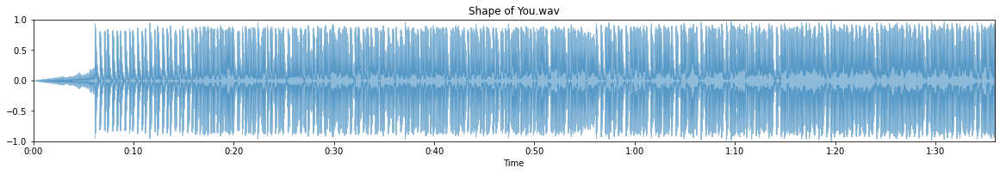

In [5]:
recarr,sr=librosa.load(filename)
plt.figure(figsize=(20,12))
plt.subplot(4,1,1)
ld.waveplot(recarr,alpha=0.5)
plt.title(filename)
plt.ylim(-1,1)

In [6]:
def ftransform(signal,title,sr,f_ratio):
    ft=np.fft.fft(signal)
    mag_spec=np.abs(ft)
    
    plt.figure(figsize=(12,5))
    frequency=np.linspace(0,sr,len(mag_spec))
    num_freq_bins=int(len(frequency)*f_ratio)
    plt.plot(frequency[:num_freq_bins],mag_spec[:num_freq_bins])
    plt.xlabel('Frequency')
    plt.title(title)
    
    plt.show()

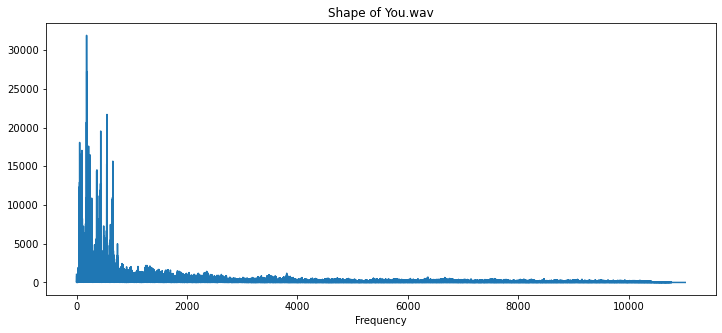

In [7]:
ftransform(recarr,filename,sr,0.5)

In [8]:
FRAME_SIZE=2048
HOP_SIZE=512

In [9]:
stft_recarr=librosa.stft(recarr,n_fft=FRAME_SIZE,hop_length=HOP_SIZE)

In [10]:
Y_recarr=(np.abs(stft_recarr))**2

In [11]:
def plot_spectrogram(Y,sr,hop_length,y_axis='linear'):
    plt.figure(figsize=(25,10))
    librosa.display.specshow(Y,
                             sr=sr,
                             hop_length=hop_length,
                             x_axis='time',
                             y_axis=y_axis)
    plt.colorbar(format='%+0.2f')

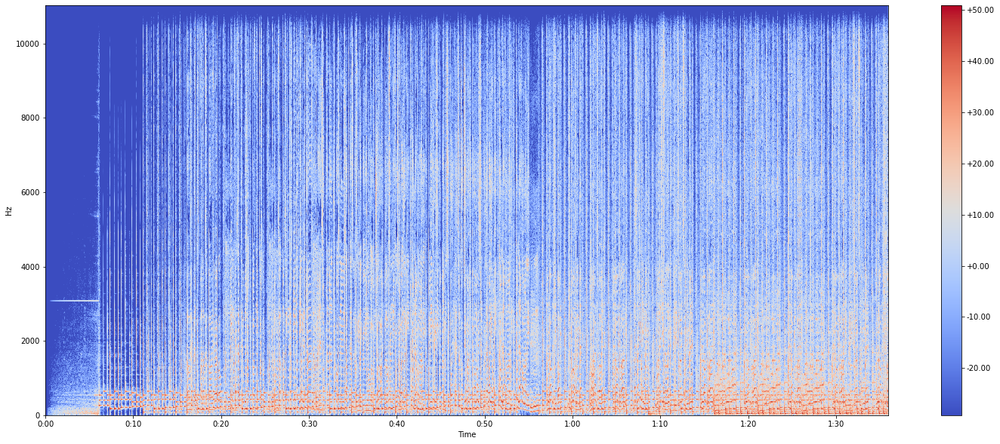

In [12]:
Y_log_recarr=librosa.power_to_db(Y_recarr)
plot_spectrogram(Y_log_recarr,sr,HOP_SIZE)

In [13]:
start_time = time.time()
m,n=Y_recarr.shape
final_matrix = np.zeros((m,n))
count=0

for i in range(0,m-99):
    for j in range(0,n-99):
        mat = Y_recarr[i:i+100,j:j+100]
        r,c, = np.where(mat == np.amax(mat))
        final_matrix[(r+i),(j+c)] = 1
        
print(final_matrix)
print("--- %s seconds ---" % (time.time() - start_time))   

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
--- 176.37471437454224 seconds ---


In [14]:
mycursor=mydb.cursor()
message="SELECT song_id FROM ref where Song_name=%s"
mycursor.execute(message,sub)
songid=mycursor.fetchall()
print((songid[0])[0])

5


In [15]:
start_time = time.time()
mycursor=mydb.cursor()
hashes=list([])
for i in range(10,m-10):
    for j in range(n-100):
        if final_matrix[i][j]==1:
            ll,ul=j+10,j+100
            lb,ub=i-10,i+10
            for y in range(lb,ub+1):
                for x in range(ll,ul+1):
                    if final_matrix[y][x]==1:
                        hashvalue=hashlib.sha224(f"{str(i)}|{str(y)}|{str(x-j)}".encode('utf-8')).hexdigest()
                        value=[hashvalue,(songid[0])[0],i]
                        prompt="INSERT INTO songsource(hashval_,song_id,offset_) VALUES (%s, %s, %s)"
                        mycursor.execute(prompt,value)
                        mydb.commit()
print("--- %s seconds ---" % (time.time() - start_time))                        

--- 207.0560188293457 seconds ---
